In [4]:
import soundfile as sf
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio
filename = '[ONTIVA.COM]-Audrey Napoleon - Poison (OFFICIAL AUDIO)-HQ'
data, samplerate = sf.read(filename + ".wav", dtype='float64')
sample_len = len(data)/samplerate
print(sample_len,samplerate)

281.25170833333334 48000


[[0. 0.]
 [0. 0.]
 [0. 0.]
 ...
 [0. 0.]
 [0. 0.]
 [0. 0.]]


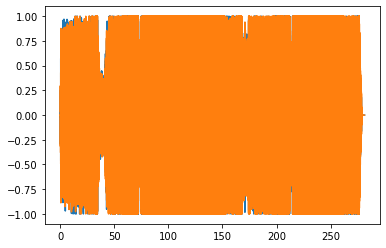

In [5]:
x = np.linspace(0, sample_len, len(data))
plt.plot(x, data)
print(data)

In [6]:
from numba import njit

@njit
def autocorrelation(data, m):
    shifted_data = np.zeros(shape=data.shape)
    shifted_data[m:] = data[:len(data)-m]
    ac = np.zeros(shape=data.shape)
    for i in range(data.shape[0]):
        ac[i] = data[i] * shifted_data[i]
    return np.sum(ac)

def chunks(data, chunk_size):
    chunk_begin = 0
    for chunk_end in range(chunk_size, len(data), chunk_size):
        yield data[chunk_begin:chunk_end], chunk_begin, chunk_end
        chunk_begin = chunk_end

In [7]:
import scipy.signal
chunk_begin = 0
chunk_size = 2048
freqs = []
for chunk, chunk_begin, chunk_end in chunks(data, chunk_size):
    ac = np.array([autocorrelation(chunk, m) for m in range(chunk_size//2)])
    peaks, props = scipy.signal.find_peaks(ac, height=0)
    if len(peaks) == 0:
        freq = 0
    else:
        max_peak_loc = np.argmax(props['peak_heights'])
        print(peaks[max_peak_loc], props['peak_heights'][max_peak_loc])
        freq = samplerate/peaks[max_peak_loc]
    freqs.append(freq)
    print(f'Chunk {chunk_begin}:{chunk_end}. Frequency = {freq}')



Chunk 0:2048. Frequency = 0
Chunk 2048:4096. Frequency = 0
Chunk 4096:6144. Frequency = 0
Chunk 6144:8192. Frequency = 0
Chunk 8192:10240. Frequency = 0
Chunk 10240:12288. Frequency = 0
61 14.90856798645109
Chunk 12288:14336. Frequency = 786.8852459016393
61 3.9904650961980224
Chunk 14336:16384. Frequency = 786.8852459016393
241 0.6201463649049401
Chunk 16384:18432. Frequency = 199.1701244813278
4 4.914477477781475
Chunk 18432:20480. Frequency = 12000.0
483 1.472439005970955
Chunk 20480:22528. Frequency = 99.37888198757764
162 3.33339696098119
Chunk 22528:24576. Frequency = 296.2962962962963
3 54.60176924802363
Chunk 24576:26624. Frequency = 16000.0
549 9.6507524009794
Chunk 26624:28672. Frequency = 87.43169398907104
470 5.23428085912019
Chunk 28672:30720. Frequency = 102.12765957446808
4 242.80446207057685
Chunk 30720:32768. Frequency = 12000.0
17 127.05673461407423
Chunk 32768:34816. Frequency = 2823.529411764706
8 32.41974820382893
Chunk 34816:36864. Frequency = 6000.0
14 42.2029236

7 166.92460847459733
Chunk 258048:260096. Frequency = 6857.142857142857
17 71.2081076093018
Chunk 260096:262144. Frequency = 2823.529411764706
8 32.03448469284922
Chunk 262144:264192. Frequency = 6000.0
10 38.524519542232156
Chunk 264192:266240. Frequency = 4800.0
14 11.08271842636168
Chunk 266240:268288. Frequency = 3428.5714285714284
13 7.999276455491781
Chunk 268288:270336. Frequency = 3692.3076923076924
12 5.016047763638198
Chunk 270336:272384. Frequency = 4000.0
7 14.234345072880387
Chunk 272384:274432. Frequency = 6857.142857142857
8 45.38247186038643
Chunk 274432:276480. Frequency = 6000.0
6 17.74737939517945
Chunk 276480:278528. Frequency = 8000.0
5 3.7297661770135164
Chunk 278528:280576. Frequency = 9600.0
9 2.1346733635291457
Chunk 280576:282624. Frequency = 5333.333333333333
553 0.8863056553527713
Chunk 282624:284672. Frequency = 86.79927667269439
6 5.935529554262757
Chunk 284672:286720. Frequency = 8000.0
133 1.8189443983137608
Chunk 286720:288768. Frequency = 360.902255639

469 5.583484704606235
Chunk 507904:509952. Frequency = 102.34541577825159
467 2.9008157551288605
Chunk 509952:512000. Frequency = 102.78372591006423
312 32.750061637721956
Chunk 512000:514048. Frequency = 153.84615384615384
310 18.971415108069777
Chunk 514048:516096. Frequency = 154.83870967741936
312 14.911303791217506
Chunk 516096:518144. Frequency = 153.84615384615384
3 41.133918441832066
Chunk 518144:520192. Frequency = 16000.0
549 10.171595289371908
Chunk 520192:522240. Frequency = 87.43169398907104
8 36.4945148890838
Chunk 522240:524288. Frequency = 6000.0
18 43.769975875504315
Chunk 524288:526336. Frequency = 2666.6666666666665
12 9.096381418406963
Chunk 526336:528384. Frequency = 4000.0
11 52.50818649306893
Chunk 528384:530432. Frequency = 4363.636363636364
4 259.3647500388324
Chunk 530432:532480. Frequency = 12000.0
611 30.56435329746455
Chunk 532480:534528. Frequency = 78.55973813420621
8 39.102118571288884
Chunk 534528:536576. Frequency = 6000.0
11 37.20787307526916
Chunk 53

4 10.511898416094482
Chunk 770048:772096. Frequency = 12000.0
4 165.84642627742141
Chunk 772096:774144. Frequency = 12000.0
4 94.5662939697504
Chunk 774144:776192. Frequency = 12000.0
5 19.55303479824215
Chunk 776192:778240. Frequency = 9600.0
4 14.06338792014867
Chunk 778240:780288. Frequency = 12000.0
6 9.727284332737327
Chunk 780288:782336. Frequency = 8000.0
5 14.45752599928528
Chunk 782336:784384. Frequency = 9600.0
137 39.353499226272106
Chunk 784384:786432. Frequency = 350.3649635036496
138 21.267438733018935
Chunk 786432:788480. Frequency = 347.82608695652175
276 6.7798161413520575
Chunk 788480:790528. Frequency = 173.91304347826087
3 31.08904842659831
Chunk 790528:792576. Frequency = 16000.0
3 18.8400523904711
Chunk 792576:794624. Frequency = 16000.0
7 42.47447219956666
Chunk 794624:796672. Frequency = 6857.142857142857
11 46.96656084340066
Chunk 796672:798720. Frequency = 4363.636363636364
4 29.11011970322579
Chunk 798720:800768. Frequency = 12000.0
4 117.83969933725893
Chunk

4 257.8305587572977
Chunk 1030144:1032192. Frequency = 12000.0
5 69.4121987009421
Chunk 1032192:1034240. Frequency = 9600.0
13 42.893653619103134
Chunk 1034240:1036288. Frequency = 3692.3076923076924
13 24.14421630371362
Chunk 1036288:1038336. Frequency = 3692.3076923076924
11 9.77788439206779
Chunk 1038336:1040384. Frequency = 4363.636363636364
4 20.810945434495807
Chunk 1040384:1042432. Frequency = 12000.0
4 11.108489194884896
Chunk 1042432:1044480. Frequency = 12000.0
6 123.83156116772443
Chunk 1044480:1046528. Frequency = 8000.0
4 70.46356458123773
Chunk 1046528:1048576. Frequency = 12000.0
4 27.614589656703174
Chunk 1048576:1050624. Frequency = 12000.0
6 11.58463344257325
Chunk 1050624:1052672. Frequency = 8000.0
6 14.656872171908617
Chunk 1052672:1054720. Frequency = 8000.0
4 14.135868519544601
Chunk 1054720:1056768. Frequency = 12000.0
154 9.558463846333325
Chunk 1056768:1058816. Frequency = 311.68831168831167
154 13.460808070376515
Chunk 1058816:1060864. Frequency = 311.6883116

4 36.15669197123498
Chunk 1288192:1290240. Frequency = 12000.0
5 22.728985656052828
Chunk 1290240:1292288. Frequency = 9600.0
5 15.278945041820407
Chunk 1292288:1294336. Frequency = 9600.0
4 75.42691775318235
Chunk 1294336:1296384. Frequency = 12000.0
4 58.512990817427635
Chunk 1296384:1298432. Frequency = 12000.0
4 52.61180495470762
Chunk 1298432:1300480. Frequency = 12000.0
4 292.34287018701434
Chunk 1300480:1302528. Frequency = 12000.0
5 221.82190855033696
Chunk 1302528:1304576. Frequency = 9600.0
6 94.31052469834685
Chunk 1304576:1306624. Frequency = 8000.0
7 44.51890244986862
Chunk 1306624:1308672. Frequency = 6857.142857142857
12 30.171722422353923
Chunk 1308672:1310720. Frequency = 4000.0
4 28.771414823830128
Chunk 1310720:1312768. Frequency = 12000.0
5 38.83706470299512
Chunk 1312768:1314816. Frequency = 9600.0
5 25.25191778410226
Chunk 1314816:1316864. Frequency = 9600.0
6 172.30535384174436
Chunk 1316864:1318912. Frequency = 8000.0
4 87.47977978177369
Chunk 1318912:1320960. F

36 19.970296630635858
Chunk 1538048:1540096. Frequency = 1333.3333333333333
35 22.061426393687725
Chunk 1540096:1542144. Frequency = 1371.4285714285713
15 15.782725906930864
Chunk 1542144:1544192. Frequency = 3200.0
15 11.369970734231174
Chunk 1544192:1546240. Frequency = 3200.0
35 7.246545159257948
Chunk 1546240:1548288. Frequency = 1371.4285714285713
14 8.214748377911747
Chunk 1548288:1550336. Frequency = 3428.5714285714284
15 5.0149967866018414
Chunk 1550336:1552384. Frequency = 3200.0
35 8.556080421432853
Chunk 1552384:1554432. Frequency = 1371.4285714285713
5 770.8870044443756
Chunk 1554432:1556480. Frequency = 9600.0
6 1302.6217045038939
Chunk 1556480:1558528. Frequency = 8000.0
820 783.3551110411063
Chunk 1558528:1560576. Frequency = 58.53658536585366
6 687.0195782072842
Chunk 1560576:1562624. Frequency = 8000.0
7 291.9567804709077
Chunk 1562624:1564672. Frequency = 6857.142857142857
130 88.98826174717396
Chunk 1564672:1566720. Frequency = 369.2307692307692
6 123.4462311938405
C

5 2.511653631925583
Chunk 1779712:1781760. Frequency = 9600.0
78 68.99936973489821
Chunk 1781760:1783808. Frequency = 615.3846153846154
154 33.34318398311734
Chunk 1783808:1785856. Frequency = 311.68831168831167
154 41.13912349194288
Chunk 1785856:1787904. Frequency = 311.68831168831167
12 20.178977416828275
Chunk 1787904:1789952. Frequency = 4000.0
412 7.253099411725998
Chunk 1789952:1792000. Frequency = 116.50485436893204
818 3.9780880250036716
Chunk 1792000:1794048. Frequency = 58.67970660146699
410 5.161330056376755
Chunk 1794048:1796096. Frequency = 117.07317073170732
411 6.219886504113674
Chunk 1796096:1798144. Frequency = 116.78832116788321
154 31.17293154168874
Chunk 1798144:1800192. Frequency = 311.68831168831167
154 27.016194793395698
Chunk 1800192:1802240. Frequency = 311.68831168831167
153 25.443108720704913
Chunk 1802240:1804288. Frequency = 313.72549019607845
538 7.477808617055416
Chunk 1804288:1806336. Frequency = 89.21933085501858
308 14.299593041650951
Chunk 1806336:18

205 17.287386166863143
Chunk 2004992:2007040. Frequency = 234.14634146341464
926 13.89893150050193
Chunk 2007040:2009088. Frequency = 51.83585313174946
68 131.4075773889199
Chunk 2009088:2011136. Frequency = 705.8823529411765
69 111.75032103899866
Chunk 2011136:2013184. Frequency = 695.6521739130435
33 135.19600653089583
Chunk 2013184:2015232. Frequency = 1454.5454545454545
69 83.24415566865355
Chunk 2015232:2017280. Frequency = 695.6521739130435
69 27.32009698264301
Chunk 2017280:2019328. Frequency = 695.6521739130435
275 6.8328503128141165
Chunk 2019328:2021376. Frequency = 174.54545454545453
275 5.995806002989411
Chunk 2021376:2023424. Frequency = 174.54545454545453
275 9.573121744208038
Chunk 2023424:2025472. Frequency = 174.54545454545453
61 122.35950626246631
Chunk 2025472:2027520. Frequency = 786.8852459016393
68 74.67225959897041
Chunk 2027520:2029568. Frequency = 705.8823529411765
68 102.44168814644217
Chunk 2029568:2031616. Frequency = 705.8823529411765
68 128.2402989193797
C

6 295.52693625260144
Chunk 2234368:2236416. Frequency = 8000.0
38 284.9736936809495
Chunk 2236416:2238464. Frequency = 1263.157894736842
56 87.04687711689621
Chunk 2238464:2240512. Frequency = 857.1428571428571
57 106.54055638052523
Chunk 2240512:2242560. Frequency = 842.1052631578947
59 90.16895941831172
Chunk 2242560:2244608. Frequency = 813.5593220338983
38 108.69480900093913
Chunk 2244608:2246656. Frequency = 1263.157894736842
39 132.51097774505615
Chunk 2246656:2248704. Frequency = 1230.7692307692307
39 106.65099572017789
Chunk 2248704:2250752. Frequency = 1230.7692307692307
77 72.441475992091
Chunk 2250752:2252800. Frequency = 623.3766233766233
81 25.622723390348256
Chunk 2252800:2254848. Frequency = 592.5925925925926
92 35.09204894397408
Chunk 2254848:2256896. Frequency = 521.7391304347826
80 66.44469638261944
Chunk 2256896:2258944. Frequency = 600.0
77 128.86581556126475
Chunk 2258944:2260992. Frequency = 623.3766233766233
38 183.57405654061586
Chunk 2260992:2263040. Frequency 

122 214.75335334520787
Chunk 2463744:2465792. Frequency = 393.44262295081967
122 259.2570869475603
Chunk 2465792:2467840. Frequency = 393.44262295081967
121 201.01472677569836
Chunk 2467840:2469888. Frequency = 396.6942148760331
6 111.4906323440373
Chunk 2469888:2471936. Frequency = 8000.0
6 96.67606697324663
Chunk 2471936:2473984. Frequency = 8000.0
6 78.60960621759295
Chunk 2473984:2476032. Frequency = 8000.0
122 200.9316782085225
Chunk 2476032:2478080. Frequency = 393.44262295081967
121 247.83879882190377
Chunk 2478080:2480128. Frequency = 396.6942148760331
367 131.51378196757287
Chunk 2480128:2482176. Frequency = 130.79019073569484
367 140.43486561160535
Chunk 2482176:2484224. Frequency = 130.79019073569484
4 160.4462507525459
Chunk 2484224:2486272. Frequency = 12000.0
122 190.8671065689996
Chunk 2486272:2488320. Frequency = 393.44262295081967
122 171.79876284115016
Chunk 2488320:2490368. Frequency = 393.44262295081967
122 134.2074374863878
Chunk 2490368:2492416. Frequency = 393.44

8 147.6579723423347
Chunk 2693120:2695168. Frequency = 6000.0
26 113.27767546847463
Chunk 2695168:2697216. Frequency = 1846.1538461538462
90 77.40648871380836
Chunk 2697216:2699264. Frequency = 533.3333333333334
201 147.6452343687415
Chunk 2699264:2701312. Frequency = 238.80597014925374
56 145.2497578235343
Chunk 2701312:2703360. Frequency = 857.1428571428571
141 235.3607259793207
Chunk 2703360:2705408. Frequency = 340.4255319148936
140 246.09733272809535
Chunk 2705408:2707456. Frequency = 342.85714285714283
137 216.5299211423844
Chunk 2707456:2709504. Frequency = 350.3649635036496
68 192.9139124508947
Chunk 2709504:2711552. Frequency = 705.8823529411765
137 105.46565394848585
Chunk 2711552:2713600. Frequency = 350.3649635036496
122 248.06034924648702
Chunk 2713600:2715648. Frequency = 393.44262295081967
123 214.91431547515094
Chunk 2715648:2717696. Frequency = 390.2439024390244
126 173.36318336147815
Chunk 2717696:2719744. Frequency = 380.95238095238096
122 195.98236462008208
Chunk 27

44 126.75579694192857
Chunk 2922496:2924544. Frequency = 1090.909090909091
6 163.44624926429242
Chunk 2924544:2926592. Frequency = 8000.0
6 88.38336364831775
Chunk 2926592:2928640. Frequency = 8000.0
7 50.93259652610868
Chunk 2928640:2930688. Frequency = 6857.142857142857
5 191.92840052954853
Chunk 2930688:2932736. Frequency = 9600.0
4 411.72578665148467
Chunk 2932736:2934784. Frequency = 12000.0
4 381.46952212043107
Chunk 2934784:2936832. Frequency = 12000.0
91 245.11049966700375
Chunk 2936832:2938880. Frequency = 527.4725274725274
69 313.7028853809461
Chunk 2938880:2940928. Frequency = 695.6521739130435
88 526.3545816466212
Chunk 2940928:2942976. Frequency = 545.4545454545455
4 256.6644782209769
Chunk 2942976:2945024. Frequency = 12000.0
4 176.8654923317954
Chunk 2945024:2947072. Frequency = 12000.0
4 152.13090531062335
Chunk 2947072:2949120. Frequency = 12000.0
4 420.38857416436076
Chunk 2949120:2951168. Frequency = 12000.0
68 224.486393019557
Chunk 2951168:2953216. Frequency = 705.

138 216.51206641830504
Chunk 3155968:3158016. Frequency = 347.82608695652175
138 159.25965017266572
Chunk 3158016:3160064. Frequency = 347.82608695652175
137 117.83659279253334
Chunk 3160064:3162112. Frequency = 350.3649635036496
275 141.16287920437753
Chunk 3162112:3164160. Frequency = 174.54545454545453
24 103.80953856930137
Chunk 3164160:3166208. Frequency = 2000.0
45 401.4813046567142
Chunk 3166208:3168256. Frequency = 1066.6666666666667
122 324.41971171367913
Chunk 3168256:3170304. Frequency = 393.44262295081967
61 422.5708287237212
Chunk 3170304:3172352. Frequency = 786.8852459016393
122 273.4513044664636
Chunk 3172352:3174400. Frequency = 393.44262295081967
121 248.33932964876294
Chunk 3174400:3176448. Frequency = 396.6942148760331
36 219.7160029374063
Chunk 3176448:3178496. Frequency = 1333.3333333333333
231 132.8270449237898
Chunk 3178496:3180544. Frequency = 207.7922077922078
116 167.36168735474348
Chunk 3180544:3182592. Frequency = 413.7931034482759
116 138.7623937120661
Chu

78 397.9549845708534
Chunk 3389440:3391488. Frequency = 615.3846153846154
77 300.4121330315247
Chunk 3391488:3393536. Frequency = 623.3766233766233
77 336.431556917727
Chunk 3393536:3395584. Frequency = 623.3766233766233
77 251.99571710452437
Chunk 3395584:3397632. Frequency = 623.3766233766233
76 255.17116656061262
Chunk 3397632:3399680. Frequency = 631.578947368421
75 63.22520714998245
Chunk 3399680:3401728. Frequency = 640.0
384 40.976356527768075
Chunk 3401728:3403776. Frequency = 125.0
4 616.9691936355084
Chunk 3403776:3405824. Frequency = 12000.0
84 463.7606488149613
Chunk 3405824:3407872. Frequency = 571.4285714285714
88 313.5675618229434
Chunk 3407872:3409920. Frequency = 545.4545454545455
91 284.48364356253296
Chunk 3409920:3411968. Frequency = 527.4725274725274
93 257.5502930106595
Chunk 3411968:3414016. Frequency = 516.1290322580645
33 329.32306229975075
Chunk 3414016:3416064. Frequency = 1454.5454545454545
33 305.3756048101932
Chunk 3416064:3418112. Frequency = 1454.5454545

35 875.113409110345
Chunk 3645440:3647488. Frequency = 1371.4285714285713
44 592.0782865863293
Chunk 3647488:3649536. Frequency = 1090.909090909091
40 741.6126249926165
Chunk 3649536:3651584. Frequency = 1200.0
7 548.6728001516312
Chunk 3651584:3653632. Frequency = 6857.142857142857
4 484.05528171826154
Chunk 3653632:3655680. Frequency = 12000.0
115 293.8401592448354
Chunk 3655680:3657728. Frequency = 417.39130434782606
44 332.96095522865653
Chunk 3657728:3659776. Frequency = 1090.909090909091
7 399.4089238392189
Chunk 3659776:3661824. Frequency = 6857.142857142857
27 360.6142354840413
Chunk 3661824:3663872. Frequency = 1777.7777777777778
310 394.4415949275717
Chunk 3663872:3665920. Frequency = 154.83870967741936
32 889.3830479998142
Chunk 3665920:3667968. Frequency = 1500.0
31 888.5458152554929
Chunk 3667968:3670016. Frequency = 1548.3870967741937
34 636.7197533790022
Chunk 3670016:3672064. Frequency = 1411.764705882353
36 405.0606548367068
Chunk 3672064:3674112. Frequency = 1333.3333

135 145.37201028410345
Chunk 3883008:3885056. Frequency = 355.55555555555554
138 125.2969657452777
Chunk 3885056:3887104. Frequency = 347.82608695652175
6 210.55143784172833
Chunk 3887104:3889152. Frequency = 8000.0
551 209.17899006139487
Chunk 3889152:3891200. Frequency = 87.11433756805808
313 353.87135290540755
Chunk 3891200:3893248. Frequency = 153.3546325878594
41 753.8898900616914
Chunk 3893248:3895296. Frequency = 1170.7317073170732
41 793.6802278067917
Chunk 3895296:3897344. Frequency = 1170.7317073170732
41 449.34270626399666
Chunk 3897344:3899392. Frequency = 1170.7317073170732
57 320.0977920750156
Chunk 3899392:3901440. Frequency = 842.1052631578947
6 410.47000665869564
Chunk 3901440:3903488. Frequency = 8000.0
318 95.5372631251812
Chunk 3903488:3905536. Frequency = 150.9433962264151
131 153.4028110411018
Chunk 3905536:3907584. Frequency = 366.412213740458
137 154.3679873328656
Chunk 3907584:3909632. Frequency = 350.3649635036496
138 124.64028860721737
Chunk 3909632:3911680. 

34 230.45987578481436
Chunk 4116480:4118528. Frequency = 1411.764705882353
397 270.6832109503448
Chunk 4118528:4120576. Frequency = 120.90680100755668
32 966.6277609458193
Chunk 4120576:4122624. Frequency = 1500.0
38 702.2013820111752
Chunk 4122624:4124672. Frequency = 1263.157894736842
35 434.5569250062108
Chunk 4124672:4126720. Frequency = 1371.4285714285713
116 254.8087007002905
Chunk 4126720:4128768. Frequency = 413.7931034482759
7 387.6119127282873
Chunk 4128768:4130816. Frequency = 6857.142857142857
304 93.36645433399826
Chunk 4130816:4132864. Frequency = 157.89473684210526
104 139.79023648332804
Chunk 4132864:4134912. Frequency = 461.53846153846155
103 148.38477139454335
Chunk 4134912:4136960. Frequency = 466.0194174757282
103 122.00280913431197
Chunk 4136960:4139008. Frequency = 466.0194174757282
3 360.8147469749674
Chunk 4139008:4141056. Frequency = 16000.0
362 362.7363070361316
Chunk 4141056:4143104. Frequency = 132.59668508287294
9 1078.4341470971704
Chunk 4143104:4145152. F

45 469.43745755404234
Chunk 4349952:4352000. Frequency = 1066.6666666666667
48 421.17166513297707
Chunk 4352000:4354048. Frequency = 1000.0
136 250.81602530553937
Chunk 4354048:4356096. Frequency = 352.94117647058823
5 513.8459051297978
Chunk 4356096:4358144. Frequency = 9600.0
178 140.5354822780937
Chunk 4358144:4360192. Frequency = 269.6629213483146
138 103.9238801440224
Chunk 4360192:4362240. Frequency = 347.82608695652175
140 132.6003110203892
Chunk 4362240:4364288. Frequency = 342.85714285714283
136 98.06212494336069
Chunk 4364288:4366336. Frequency = 352.94117647058823
277 181.45790102146566
Chunk 4366336:4368384. Frequency = 173.28519855595667
26 978.7867882242426
Chunk 4368384:4370432. Frequency = 1846.1538461538462
31 890.4076858172193
Chunk 4370432:4372480. Frequency = 1548.3870967741937
41 589.3204997917637
Chunk 4372480:4374528. Frequency = 1170.7317073170732
55 753.9858348192647
Chunk 4374528:4376576. Frequency = 872.7272727272727
37 488.44290291983634
Chunk 4376576:437862

104 225.2075632493943
Chunk 4587520:4589568. Frequency = 461.53846153846155
3 397.42713237926364
Chunk 4589568:4591616. Frequency = 16000.0
102 376.4450481534004
Chunk 4591616:4593664. Frequency = 470.5882352941176
306 410.73196882847697
Chunk 4593664:4595712. Frequency = 156.86274509803923
32 1040.6292420737445
Chunk 4595712:4597760. Frequency = 1500.0
40 916.7467732019722
Chunk 4597760:4599808. Frequency = 1200.0
45 467.96915647014976
Chunk 4599808:4601856. Frequency = 1066.6666666666667
92 242.38544796593487
Chunk 4601856:4603904. Frequency = 521.7391304347826
5 527.7698338096961
Chunk 4603904:4605952. Frequency = 9600.0
5 258.3667413238436
Chunk 4605952:4608000. Frequency = 9600.0
48 163.48970056790859
Chunk 4608000:4610048. Frequency = 1000.0
137 94.55594398267567
Chunk 4610048:4612096. Frequency = 350.3649635036496
4 207.00172440055758
Chunk 4612096:4614144. Frequency = 12000.0
550 192.45039420574903
Chunk 4614144:4616192. Frequency = 87.27272727272727
300 354.4017380774021
Chunk

58 243.1973674679175
Chunk 4829184:4831232. Frequency = 827.5862068965517
6 172.8612409401685
Chunk 4831232:4833280. Frequency = 8000.0
4 160.0802888162434
Chunk 4833280:4835328. Frequency = 12000.0
136 119.14907849021256
Chunk 4835328:4837376. Frequency = 352.94117647058823
124 63.747437491081655
Chunk 4837376:4839424. Frequency = 387.0967741935484
7 174.00072784442455
Chunk 4839424:4841472. Frequency = 6857.142857142857
116 241.23453240469098
Chunk 4841472:4843520. Frequency = 413.7931034482759
315 342.17723210249096
Chunk 4843520:4845568. Frequency = 152.38095238095238
4 668.4155677678064
Chunk 4845568:4847616. Frequency = 12000.0
37 633.3559998497367
Chunk 4847616:4849664. Frequency = 1297.2972972972973
35 376.2798589365557
Chunk 4849664:4851712. Frequency = 1371.4285714285713
35 240.9258145019412
Chunk 4851712:4853760. Frequency = 1371.4285714285713
5 259.4166896836832
Chunk 4853760:4855808. Frequency = 9600.0
4 202.74505184497684
Chunk 4855808:4857856. Frequency = 12000.0
103 107

6 207.37122186273336
Chunk 5066752:5068800. Frequency = 8000.0
458 97.11704660113901
Chunk 5068800:5070848. Frequency = 104.80349344978166
5 283.6542528355494
Chunk 5070848:5072896. Frequency = 9600.0
409 136.44570816587657
Chunk 5072896:5074944. Frequency = 117.35941320293398
417 169.68717275653034
Chunk 5074944:5076992. Frequency = 115.10791366906474
50 161.9770878450945
Chunk 5076992:5079040. Frequency = 960.0
91 335.2594687221572
Chunk 5079040:5081088. Frequency = 527.4725274725274
182 204.8208679948002
Chunk 5081088:5083136. Frequency = 263.7362637362637
183 279.46566695161164
Chunk 5083136:5085184. Frequency = 262.2950819672131
510 110.95895126834512
Chunk 5085184:5087232. Frequency = 94.11764705882354
641 96.06025084666908
Chunk 5087232:5089280. Frequency = 74.88299531981279
461 131.9112488431856
Chunk 5089280:5091328. Frequency = 104.12147505422993
137 74.32227930333465
Chunk 5091328:5093376. Frequency = 350.3649635036496
10 998.4340576687828
Chunk 5093376:5095424. Frequency = 

116 243.68825926538557
Chunk 5312512:5314560. Frequency = 413.7931034482759
3 368.273716410622
Chunk 5314560:5316608. Frequency = 16000.0
3 409.178453377448
Chunk 5316608:5318656. Frequency = 16000.0
241 200.33935183566064
Chunk 5318656:5320704. Frequency = 199.1701244813278
12 1068.014816190116
Chunk 5320704:5322752. Frequency = 4000.0
13 865.4603593144566
Chunk 5322752:5324800. Frequency = 3692.3076923076924
34 551.6373750716448
Chunk 5324800:5326848. Frequency = 1411.764705882353
42 162.42922309413552
Chunk 5326848:5328896. Frequency = 1142.857142857143
22 344.7954512583092
Chunk 5328896:5330944. Frequency = 2181.818181818182
6 289.4061679011211
Chunk 5330944:5332992. Frequency = 8000.0
4 190.88670312985778
Chunk 5332992:5335040. Frequency = 12000.0
4 158.79247787036002
Chunk 5335040:5337088. Frequency = 12000.0
4 202.83785563427955
Chunk 5337088:5339136. Frequency = 12000.0
14 198.290165505372
Chunk 5339136:5341184. Frequency = 3428.5714285714284
27 245.69874833896756
Chunk 5341184

3 431.1398842846975
Chunk 5554176:5556224. Frequency = 16000.0
6 178.2933974424377
Chunk 5556224:5558272. Frequency = 8000.0
7 163.69480847846717
Chunk 5558272:5560320. Frequency = 6857.142857142857
39 84.92654511611909
Chunk 5560320:5562368. Frequency = 1230.7692307692307
35 59.32992921769619
Chunk 5562368:5564416. Frequency = 1371.4285714285713
7 184.36764052603394
Chunk 5564416:5566464. Frequency = 6857.142857142857
7 199.49151264503598
Chunk 5566464:5568512. Frequency = 6857.142857142857
284 301.8173575652763
Chunk 5568512:5570560. Frequency = 169.01408450704224
31 595.9570907885209
Chunk 5570560:5572608. Frequency = 1548.3870967741937
22 647.5547509063035
Chunk 5572608:5574656. Frequency = 2181.818181818182
40 471.69558851327747
Chunk 5574656:5576704. Frequency = 1200.0
21 333.9340645214543
Chunk 5576704:5578752. Frequency = 2285.714285714286
4 244.27891776990145
Chunk 5578752:5580800. Frequency = 12000.0
5 343.7714768908918
Chunk 5580800:5582848. Frequency = 9600.0
413 80.6108532

316 179.74788350146264
Chunk 5795840:5797888. Frequency = 151.8987341772152
4 530.0182732790709
Chunk 5797888:5799936. Frequency = 12000.0
33 468.1488160137087
Chunk 5799936:5801984. Frequency = 1454.5454545454545
6 374.80638689920306
Chunk 5801984:5804032. Frequency = 8000.0
7 409.0309087000787
Chunk 5804032:5806080. Frequency = 6857.142857142857
6 282.5077722109854
Chunk 5806080:5808128. Frequency = 8000.0
4 371.7531890729442
Chunk 5808128:5810176. Frequency = 12000.0
4 307.2440703539178
Chunk 5810176:5812224. Frequency = 12000.0
4 221.594597235322
Chunk 5812224:5814272. Frequency = 12000.0
4 341.20730550494045
Chunk 5814272:5816320. Frequency = 12000.0
4 268.70721747074276
Chunk 5816320:5818368. Frequency = 12000.0
310 457.6345965201035
Chunk 5818368:5820416. Frequency = 154.83870967741936
7 936.4976351363584
Chunk 5820416:5822464. Frequency = 6857.142857142857
6 659.5661417515948
Chunk 5822464:5824512. Frequency = 8000.0
6 525.7623909926042
Chunk 5824512:5826560. Frequency = 8000.0

116 237.03888590447605
Chunk 6037504:6039552. Frequency = 413.7931034482759
57 227.5655831238255
Chunk 6039552:6041600. Frequency = 842.1052631578947
3 357.54592653457075
Chunk 6041600:6043648. Frequency = 16000.0
3 471.01998284459114
Chunk 6043648:6045696. Frequency = 16000.0
344 430.46294578071684
Chunk 6045696:6047744. Frequency = 139.53488372093022
18 992.7491165231913
Chunk 6047744:6049792. Frequency = 2666.6666666666665
9 587.2367442548275
Chunk 6049792:6051840. Frequency = 5333.333333333333
20 276.90023391135037
Chunk 6051840:6053888. Frequency = 2400.0
22 146.60208749957383
Chunk 6053888:6055936. Frequency = 2181.818181818182
5 545.7421396188438
Chunk 6055936:6057984. Frequency = 9600.0
4 183.568251054734
Chunk 6057984:6060032. Frequency = 12000.0
4 199.5659860931337
Chunk 6060032:6062080. Frequency = 12000.0
21 52.40791325457394
Chunk 6062080:6064128. Frequency = 2285.714285714286
6 257.94960597902536
Chunk 6064128:6066176. Frequency = 8000.0
91 181.39943543449044
Chunk 606617

9 909.0082940785214
Chunk 6275072:6277120. Frequency = 5333.333333333333
34 665.6387584041804
Chunk 6277120:6279168. Frequency = 1411.764705882353
34 457.6720591895282
Chunk 6279168:6281216. Frequency = 1411.764705882353
38 190.34129038266838
Chunk 6281216:6283264. Frequency = 1263.157894736842
6 178.96520812995732
Chunk 6283264:6285312. Frequency = 8000.0
116 87.33824809361249
Chunk 6285312:6287360. Frequency = 413.7931034482759
72 57.60786500759423
Chunk 6287360:6289408. Frequency = 666.6666666666666
7 149.4750753911212
Chunk 6289408:6291456. Frequency = 6857.142857142857
7 191.94786200486124
Chunk 6291456:6293504. Frequency = 6857.142857142857
571 95.95198526512831
Chunk 6293504:6295552. Frequency = 84.0630472854641
370 129.11890577990562
Chunk 6295552:6297600. Frequency = 129.72972972972974
14 691.3444155734032
Chunk 6297600:6299648. Frequency = 3428.5714285714284
41 480.233775164932
Chunk 6299648:6301696. Frequency = 1170.7317073170732
26 320.25778312422335
Chunk 6301696:6303744. 

4 140.53781620785594
Chunk 6508544:6510592. Frequency = 12000.0
6 122.3666563173756
Chunk 6510592:6512640. Frequency = 8000.0
24 72.86301330383867
Chunk 6512640:6514688. Frequency = 2000.0
10 146.53483750205487
Chunk 6514688:6516736. Frequency = 4800.0
7 409.3573302924633
Chunk 6516736:6518784. Frequency = 6857.142857142857
19 177.87796022556722
Chunk 6518784:6520832. Frequency = 2526.315789473684
9 450.2352122105658
Chunk 6520832:6522880. Frequency = 5333.333333333333
15 499.8912320146337
Chunk 6522880:6524928. Frequency = 3200.0
33 502.05569439940155
Chunk 6524928:6526976. Frequency = 1454.5454545454545
36 411.7152169737965
Chunk 6526976:6529024. Frequency = 1333.3333333333333
7 371.7385090235621
Chunk 6529024:6531072. Frequency = 6857.142857142857
6 188.8783471705392
Chunk 6531072:6533120. Frequency = 8000.0
6 428.28104492649436
Chunk 6533120:6535168. Frequency = 8000.0
183 106.99309905059636
Chunk 6535168:6537216. Frequency = 262.2950819672131
27 84.14077354222536
Chunk 6537216:653

34 464.7400898458436
Chunk 6746112:6748160. Frequency = 1411.764705882353
26 502.4925503851846
Chunk 6748160:6750208. Frequency = 1846.1538461538462
32 458.15091818291694
Chunk 6750208:6752256. Frequency = 1500.0
33 522.7364685665816
Chunk 6752256:6754304. Frequency = 1454.5454545454545
116 478.96366732846946
Chunk 6754304:6756352. Frequency = 413.7931034482759
116 300.1301432242617
Chunk 6756352:6758400. Frequency = 413.7931034482759
5 434.70897759124637
Chunk 6758400:6760448. Frequency = 9600.0
4 390.3405580399558
Chunk 6760448:6762496. Frequency = 12000.0
115 255.75356141477823
Chunk 6762496:6764544. Frequency = 417.39130434782606
116 375.3412587232888
Chunk 6764544:6766592. Frequency = 413.7931034482759
3 416.87901514116675
Chunk 6766592:6768640. Frequency = 16000.0
116 300.3479689452797
Chunk 6768640:6770688. Frequency = 413.7931034482759
316 400.280149823986
Chunk 6770688:6772736. Frequency = 151.8987341772152
32 756.3567068846896
Chunk 6772736:6774784. Frequency = 1500.0
44 740.

91 427.7597826682031
Chunk 6979584:6981632. Frequency = 527.4725274725274
92 302.7694235527888
Chunk 6981632:6983680. Frequency = 521.7391304347826
92 231.8288350990042
Chunk 6983680:6985728. Frequency = 521.7391304347826
5 296.920756210573
Chunk 6985728:6987776. Frequency = 9600.0
103 226.44735020585358
Chunk 6987776:6989824. Frequency = 466.0194174757282
103 350.8099531363696
Chunk 6989824:6991872. Frequency = 466.0194174757282
208 95.56370299030095
Chunk 6991872:6993920. Frequency = 230.76923076923077
349 158.13034371752292
Chunk 6993920:6995968. Frequency = 137.53581661891118
233 109.23628403339535
Chunk 6995968:6998016. Frequency = 206.00858369098714
345 418.9466412458569
Chunk 6998016:7000064. Frequency = 139.1304347826087
28 818.9443908026442
Chunk 7000064:7002112. Frequency = 1714.2857142857142
68 783.5972504019737
Chunk 7002112:7004160. Frequency = 705.8823529411765
69 526.1967271892354
Chunk 7004160:7006208. Frequency = 695.6521739130435
69 345.332786639221
Chunk 7006208:7008

5 321.12389752920717
Chunk 7213056:7215104. Frequency = 9600.0
309 66.4212163798511
Chunk 7215104:7217152. Frequency = 155.3398058252427
138 111.53867824841291
Chunk 7217152:7219200. Frequency = 347.82608695652175
151 75.58027454931289
Chunk 7219200:7221248. Frequency = 317.88079470198676
3 58.036297438666224
Chunk 7221248:7223296. Frequency = 16000.0
30 148.49405944813043
Chunk 7223296:7225344. Frequency = 1600.0
367 238.34220095723867
Chunk 7225344:7227392. Frequency = 130.79019073569484
45 688.5754696521908
Chunk 7227392:7229440. Frequency = 1066.6666666666667
45 505.9604723472148
Chunk 7229440:7231488. Frequency = 1066.6666666666667
35 326.592967428267
Chunk 7231488:7233536. Frequency = 1371.4285714285713
35 197.9103268776089
Chunk 7233536:7235584. Frequency = 1371.4285714285713
4 173.15261024422944
Chunk 7235584:7237632. Frequency = 12000.0
93 128.94166539423168
Chunk 7237632:7239680. Frequency = 516.1290322580645
91 61.71242245286703
Chunk 7239680:7241728. Frequency = 527.4725274

92 207.2148123960942
Chunk 7446528:7448576. Frequency = 521.7391304347826
92 221.36755537148565
Chunk 7448576:7450624. Frequency = 521.7391304347826
32 448.89080209471285
Chunk 7450624:7452672. Frequency = 1500.0
35 160.49811651185155
Chunk 7452672:7454720. Frequency = 1371.4285714285713
137 149.5342177581042
Chunk 7454720:7456768. Frequency = 350.3649635036496
137 157.49312298931181
Chunk 7456768:7458816. Frequency = 350.3649635036496
137 160.6557225305587
Chunk 7458816:7460864. Frequency = 350.3649635036496
137 158.90590381622314
Chunk 7460864:7462912. Frequency = 350.3649635036496
137 147.36873587220907
Chunk 7462912:7464960. Frequency = 350.3649635036496
69 173.4681549910456
Chunk 7464960:7467008. Frequency = 695.6521739130435
68 133.40293242502958
Chunk 7467008:7469056. Frequency = 705.8823529411765
275 35.33736315649003
Chunk 7469056:7471104. Frequency = 174.54545454545453
275 81.08356280531734
Chunk 7471104:7473152. Frequency = 174.54545454545453
141 91.93057997897267
Chunk 7473

115 628.2597618158907
Chunk 7671808:7673856. Frequency = 417.39130434782606
115 431.05529559683055
Chunk 7673856:7675904. Frequency = 417.39130434782606
164 287.6719862995669
Chunk 7675904:7677952. Frequency = 292.6829268292683
362 323.40824642032385
Chunk 7677952:7680000. Frequency = 132.59668508287294
184 562.9642121316865
Chunk 7680000:7682048. Frequency = 260.8695652173913
139 231.8479472566396
Chunk 7682048:7684096. Frequency = 345.32374100719426
275 172.80249997414649
Chunk 7684096:7686144. Frequency = 174.54545454545453
273 140.4479416627437
Chunk 7686144:7688192. Frequency = 175.82417582417582
16 60.7560617281124
Chunk 7688192:7690240. Frequency = 3000.0
51 19.18914456292987
Chunk 7690240:7692288. Frequency = 941.1764705882352
270 7.639834730885923
Chunk 7692288:7694336. Frequency = 177.77777777777777
92 94.56323425937444
Chunk 7694336:7696384. Frequency = 521.7391304347826
91 220.08893864043057
Chunk 7696384:7698432. Frequency = 527.4725274725274
92 183.74464133847505
Chunk 76

122 157.20019748341292
Chunk 7897088:7899136. Frequency = 393.44262295081967
122 137.79130887240171
Chunk 7899136:7901184. Frequency = 393.44262295081967
122 156.77759457752109
Chunk 7901184:7903232. Frequency = 393.44262295081967
252 114.90826844517142
Chunk 7903232:7905280. Frequency = 190.47619047619048
5 260.10764513816684
Chunk 7905280:7907328. Frequency = 9600.0
307 122.16003717947751
Chunk 7907328:7909376. Frequency = 156.35179153094464
208 210.9311708882451
Chunk 7909376:7911424. Frequency = 230.76923076923077
6 197.21729289926589
Chunk 7911424:7913472. Frequency = 8000.0
309 123.37028456199914
Chunk 7913472:7915520. Frequency = 155.3398058252427
5 391.7667875504121
Chunk 7915520:7917568. Frequency = 9600.0
5 207.80138885602355
Chunk 7917568:7919616. Frequency = 9600.0
307 122.93588658981025
Chunk 7919616:7921664. Frequency = 156.35179153094464
5 354.00059744436294
Chunk 7921664:7923712. Frequency = 9600.0
6 61.46843625511974
Chunk 7923712:7925760. Frequency = 8000.0
22 273.482

103 136.4794875960797
Chunk 8128512:8130560. Frequency = 466.0194174757282
103 109.21440850570798
Chunk 8130560:8132608. Frequency = 466.0194174757282
9 76.28214314579964
Chunk 8132608:8134656. Frequency = 5333.333333333333
136 163.52863183338195
Chunk 8134656:8136704. Frequency = 352.94117647058823
137 158.80206627305597
Chunk 8136704:8138752. Frequency = 350.3649635036496
139 181.4122226377949
Chunk 8138752:8140800. Frequency = 345.32374100719426
138 139.7419886086136
Chunk 8140800:8142848. Frequency = 347.82608695652175
137 128.4963895548135
Chunk 8142848:8144896. Frequency = 350.3649635036496
137 129.09339827578515
Chunk 8144896:8146944. Frequency = 350.3649635036496
137 152.9609397361055
Chunk 8146944:8148992. Frequency = 350.3649635036496
141 162.63387784734368
Chunk 8148992:8151040. Frequency = 340.4255319148936
138 134.78481777664274
Chunk 8151040:8153088. Frequency = 347.82608695652175
136 79.052110735327
Chunk 8153088:8155136. Frequency = 352.94117647058823
58 72.822488259524

139 209.4316114075482
Chunk 8351744:8353792. Frequency = 345.32374100719426
140 197.4541154652834
Chunk 8353792:8355840. Frequency = 342.85714285714283
136 131.15855917241424
Chunk 8355840:8357888. Frequency = 352.94117647058823
47 235.95621824078262
Chunk 8357888:8359936. Frequency = 1021.2765957446809
33 444.63427397143096
Chunk 8359936:8361984. Frequency = 1454.5454545454545
34 375.4920950420201
Chunk 8361984:8364032. Frequency = 1411.764705882353
59 318.1778446342796
Chunk 8364032:8366080. Frequency = 813.5593220338983
51 294.1302582975477
Chunk 8366080:8368128. Frequency = 941.1764705882352
35 340.0248877136037
Chunk 8368128:8370176. Frequency = 1371.4285714285713
51 337.44743429590017
Chunk 8370176:8372224. Frequency = 941.1764705882352
114 367.0147263528779
Chunk 8372224:8374272. Frequency = 421.05263157894734
45 355.54963172227144
Chunk 8374272:8376320. Frequency = 1066.6666666666667
8 399.48831975087523
Chunk 8376320:8378368. Frequency = 6000.0
116 315.7691390719265
Chunk 8378

78 147.04051333572716
Chunk 8574976:8577024. Frequency = 615.3846153846154
307 149.82170971482992
Chunk 8577024:8579072. Frequency = 156.35179153094464
105 114.2517589526251
Chunk 8579072:8581120. Frequency = 457.14285714285717
306 142.64595473650843
Chunk 8581120:8583168. Frequency = 156.86274509803923
103 136.0552926203236
Chunk 8583168:8585216. Frequency = 466.0194174757282
38 251.34386648237705
Chunk 8585216:8587264. Frequency = 1263.157894736842
92 157.71506689395756
Chunk 8587264:8589312. Frequency = 521.7391304347826
94 133.59216375742108
Chunk 8589312:8591360. Frequency = 510.63829787234044
91 135.99351694155484
Chunk 8591360:8593408. Frequency = 527.4725274725274
463 110.80934237875044
Chunk 8593408:8595456. Frequency = 103.67170626349892
154 112.91521772742271
Chunk 8595456:8597504. Frequency = 311.68831168831167
56 102.52378669846803
Chunk 8597504:8599552. Frequency = 857.1428571428571
136 187.7999476986006
Chunk 8599552:8601600. Frequency = 352.94117647058823
138 161.025496

4 149.48296889662743
Chunk 8806400:8808448. Frequency = 12000.0
4 165.12030626274645
Chunk 8808448:8810496. Frequency = 12000.0
4 305.28652759827673
Chunk 8810496:8812544. Frequency = 12000.0
360 125.63166287913918
Chunk 8812544:8814592. Frequency = 133.33333333333334
121 155.9659323291853
Chunk 8814592:8816640. Frequency = 396.6942148760331
121 145.13708207383752
Chunk 8816640:8818688. Frequency = 396.6942148760331
123 156.60789613891393
Chunk 8818688:8820736. Frequency = 390.2439024390244
123 145.51677298452705
Chunk 8820736:8822784. Frequency = 390.2439024390244
9 122.09393170010298
Chunk 8822784:8824832. Frequency = 5333.333333333333
122 158.680014395155
Chunk 8824832:8826880. Frequency = 393.44262295081967
122 138.9436063580215
Chunk 8826880:8828928. Frequency = 393.44262295081967
367 159.21312323585153
Chunk 8828928:8830976. Frequency = 130.79019073569484
122 161.7353328531608
Chunk 8830976:8833024. Frequency = 393.44262295081967
369 81.37527965102345
Chunk 8833024:8835072. Frequ

10 432.469591059722
Chunk 9039872:9041920. Frequency = 4800.0
10 148.31065117754042
Chunk 9041920:9043968. Frequency = 4800.0
12 159.33567002415657
Chunk 9043968:9046016. Frequency = 4000.0
12 86.31102771032602
Chunk 9046016:9048064. Frequency = 4000.0
11 12.510764844715595
Chunk 9048064:9050112. Frequency = 4363.636363636364
409 14.705678685568273
Chunk 9050112:9052160. Frequency = 117.35941320293398
409 19.250976383686066
Chunk 9052160:9054208. Frequency = 117.35941320293398
39 49.27935167402029
Chunk 9054208:9056256. Frequency = 1230.7692307692307
70 89.94674710649997
Chunk 9056256:9058304. Frequency = 685.7142857142857
10 149.7673217980191
Chunk 9058304:9060352. Frequency = 4800.0
10 94.7625497924164
Chunk 9060352:9062400. Frequency = 4800.0
10 111.55456902459264
Chunk 9062400:9064448. Frequency = 4800.0
34 110.29665055312216
Chunk 9064448:9066496. Frequency = 1411.764705882353
68 61.53437043912709
Chunk 9066496:9068544. Frequency = 705.8823529411765
69 25.670000050216913
Chunk 906

137 220.70639876369387
Chunk 9271296:9273344. Frequency = 350.3649635036496
137 193.04870309773833
Chunk 9273344:9275392. Frequency = 350.3649635036496
138 180.50517659913749
Chunk 9275392:9277440. Frequency = 347.82608695652175
140 208.0644633313641
Chunk 9277440:9279488. Frequency = 342.85714285714283
142 170.2877885196358
Chunk 9279488:9281536. Frequency = 338.0281690140845
143 126.40410118922591
Chunk 9281536:9283584. Frequency = 335.6643356643357
144 159.590712107718
Chunk 9283584:9285632. Frequency = 333.3333333333333
141 211.7565547041595
Chunk 9285632:9287680. Frequency = 340.4255319148936
148 169.79472224600613
Chunk 9287680:9289728. Frequency = 324.3243243243243
148 156.80605696234852
Chunk 9289728:9291776. Frequency = 324.3243243243243
139 145.6867144489661
Chunk 9291776:9293824. Frequency = 345.32374100719426
154 37.83502322435379
Chunk 9293824:9295872. Frequency = 311.68831168831167
332 10.202513471245766
Chunk 9295872:9297920. Frequency = 144.57831325301206
44 22.72565041

41 272.36875381320715
Chunk 9500672:9502720. Frequency = 1170.7317073170732
41 313.8646296095103
Chunk 9502720:9504768. Frequency = 1170.7317073170732
41 343.63149056583643
Chunk 9504768:9506816. Frequency = 1170.7317073170732
71 510.6023613717407
Chunk 9506816:9508864. Frequency = 676.056338028169
72 303.8796470910311
Chunk 9508864:9510912. Frequency = 666.6666666666666
278 218.28309847600758
Chunk 9510912:9512960. Frequency = 172.66187050359713
71 186.84712187573314
Chunk 9512960:9515008. Frequency = 676.056338028169
126 328.222377050668
Chunk 9515008:9517056. Frequency = 380.95238095238096
124 312.59612201619893
Chunk 9517056:9519104. Frequency = 387.0967741935484
122 222.458238016814
Chunk 9519104:9521152. Frequency = 393.44262295081967
122 214.90316542610526
Chunk 9521152:9523200. Frequency = 393.44262295081967
121 250.85498743504286
Chunk 9523200:9525248. Frequency = 396.6942148760331
247 182.76490732375532
Chunk 9525248:9527296. Frequency = 194.33198380566802
38 281.828920225612

58 80.82300533819944
Chunk 9730048:9732096. Frequency = 827.5862068965517
102 218.4255213625729
Chunk 9732096:9734144. Frequency = 470.5882352941176
100 159.40117484796792
Chunk 9734144:9736192. Frequency = 480.0
4 286.20598576497287
Chunk 9736192:9738240. Frequency = 12000.0
5 301.7690729070455
Chunk 9738240:9740288. Frequency = 9600.0
183 176.28805415146053
Chunk 9740288:9742336. Frequency = 262.2950819672131
92 165.32476121000946
Chunk 9742336:9744384. Frequency = 521.7391304347826
91 136.84275430906564
Chunk 9744384:9746432. Frequency = 527.4725274725274
276 75.38484987057745
Chunk 9746432:9748480. Frequency = 173.91304347826087
63 56.21966208331287
Chunk 9748480:9750528. Frequency = 761.9047619047619
10 32.577734558843076
Chunk 9750528:9752576. Frequency = 4800.0
295 194.8051449507475
Chunk 9752576:9754624. Frequency = 162.71186440677965
45 273.1915308861062
Chunk 9754624:9756672. Frequency = 1066.6666666666667
141 224.50561217404902
Chunk 9756672:9758720. Frequency = 340.42553191

139 176.83257426135242
Chunk 9959424:9961472. Frequency = 345.32374100719426
137 270.2699149195105
Chunk 9961472:9963520. Frequency = 350.3649635036496
136 227.0682199075818
Chunk 9963520:9965568. Frequency = 352.94117647058823
77 203.71875001955777
Chunk 9965568:9967616. Frequency = 623.3766233766233
24 76.32488956023008
Chunk 9967616:9969664. Frequency = 2000.0
58 121.55496004037559
Chunk 9969664:9971712. Frequency = 827.5862068965517
15 157.17952759750187
Chunk 9971712:9973760. Frequency = 3200.0
125 85.12675267644227
Chunk 9973760:9975808. Frequency = 384.0
121 103.8473100438714
Chunk 9975808:9977856. Frequency = 396.6942148760331
128 88.7048372104764
Chunk 9977856:9979904. Frequency = 375.0
23 277.278542756103
Chunk 9979904:9981952. Frequency = 2086.9565217391305
54 157.41892900504172
Chunk 9981952:9984000. Frequency = 888.8888888888889
115 180.98137588333338
Chunk 9984000:9986048. Frequency = 417.39130434782606
118 216.78872384130955
Chunk 9986048:9988096. Frequency = 406.7796610

92 139.72951888106763
Chunk 10188800:10190848. Frequency = 521.7391304347826
5 123.92631262913346
Chunk 10190848:10192896. Frequency = 9600.0
5 122.89986089803278
Chunk 10192896:10194944. Frequency = 9600.0
102 189.36372299864888
Chunk 10194944:10196992. Frequency = 470.5882352941176
103 246.56484967283905
Chunk 10196992:10199040. Frequency = 466.0194174757282
103 219.2494998201728
Chunk 10199040:10201088. Frequency = 466.0194174757282
103 218.20841083023697
Chunk 10201088:10203136. Frequency = 466.0194174757282
103 206.66040839068592
Chunk 10203136:10205184. Frequency = 466.0194174757282
103 244.7697795284912
Chunk 10205184:10207232. Frequency = 466.0194174757282
103 209.86116184480488
Chunk 10207232:10209280. Frequency = 466.0194174757282
5 222.04332897718996
Chunk 10209280:10211328. Frequency = 9600.0
5 185.23734447639436
Chunk 10211328:10213376. Frequency = 9600.0
5 176.77398611232638
Chunk 10213376:10215424. Frequency = 9600.0
5 164.01665435172617
Chunk 10215424:10217472. Frequenc

7 187.45722933206707
Chunk 10418176:10420224. Frequency = 6857.142857142857
91 150.39111107122153
Chunk 10420224:10422272. Frequency = 527.4725274725274
307 227.89055324159563
Chunk 10422272:10424320. Frequency = 156.35179153094464
29 480.95254102535546
Chunk 10424320:10426368. Frequency = 1655.1724137931035
30 520.6191176557913
Chunk 10426368:10428416. Frequency = 1600.0
92 350.33600474428385
Chunk 10428416:10430464. Frequency = 521.7391304347826
92 176.10985140129924
Chunk 10430464:10432512. Frequency = 521.7391304347826
6 278.0300504574552
Chunk 10432512:10434560. Frequency = 8000.0
7 194.09857461508363
Chunk 10434560:10436608. Frequency = 6857.142857142857
103 99.70258303452283
Chunk 10436608:10438656. Frequency = 466.0194174757282
17 128.42270653881133
Chunk 10438656:10440704. Frequency = 2823.529411764706
9 226.7992421463132
Chunk 10440704:10442752. Frequency = 5333.333333333333
10 75.09016095660627
Chunk 10442752:10444800. Frequency = 4800.0
333 513.1109270295128
Chunk 10444800:

36 574.9167898371816
Chunk 10651648:10653696. Frequency = 1333.3333333333333
36 514.9161950908601
Chunk 10653696:10655744. Frequency = 1333.3333333333333
9 349.8274883348495
Chunk 10655744:10657792. Frequency = 5333.333333333333
11 181.57418934628367
Chunk 10657792:10659840. Frequency = 4363.636363636364
5 445.1218498405069
Chunk 10659840:10661888. Frequency = 9600.0
40 74.98951470479369
Chunk 10661888:10663936. Frequency = 1200.0
138 65.03321417234838
Chunk 10663936:10665984. Frequency = 347.82608695652175
18 56.16738307196647
Chunk 10665984:10668032. Frequency = 2666.6666666666665
10 63.07590884435922
Chunk 10668032:10670080. Frequency = 4800.0
203 39.969973942264915
Chunk 10670080:10672128. Frequency = 236.45320197044336
367 272.53556457255036
Chunk 10672128:10674176. Frequency = 130.79019073569484
21 656.0351848453283
Chunk 10674176:10676224. Frequency = 2285.714285714286
25 619.8066836902872
Chunk 10676224:10678272. Frequency = 1920.0
32 346.58378187473863
Chunk 10678272:10680320.

136 113.07789319381118
Chunk 10885120:10887168. Frequency = 352.94117647058823
4 361.34978641197085
Chunk 10887168:10889216. Frequency = 12000.0
412 105.03259989898652
Chunk 10889216:10891264. Frequency = 116.50485436893204
138 124.99638224765658
Chunk 10891264:10893312. Frequency = 347.82608695652175
282 273.65553930960596
Chunk 10893312:10895360. Frequency = 170.2127659574468
139 112.88519335258752
Chunk 10895360:10897408. Frequency = 345.32374100719426
276 303.6583099998534
Chunk 10897408:10899456. Frequency = 173.91304347826087
29 942.9390761544928
Chunk 10899456:10901504. Frequency = 1655.1724137931035
34 822.6061494350433
Chunk 10901504:10903552. Frequency = 1411.764705882353
75 478.2797920303419
Chunk 10903552:10905600. Frequency = 640.0
40 613.7086087521166
Chunk 10905600:10907648. Frequency = 1200.0
40 454.0576352318749
Chunk 10907648:10909696. Frequency = 1200.0
5 339.41620638407767
Chunk 10909696:10911744. Frequency = 9600.0
36 278.43014416098595
Chunk 10911744:10913792. Fre

4 406.5283951340243
Chunk 11114496:11116544. Frequency = 12000.0
72 222.8591257063672
Chunk 11116544:11118592. Frequency = 666.6666666666666
58 214.43204510118812
Chunk 11118592:11120640. Frequency = 827.5862068965517
6 355.2124940128997
Chunk 11120640:11122688. Frequency = 8000.0
66 338.5992131270468
Chunk 11122688:11124736. Frequency = 727.2727272727273
306 383.1965073365718
Chunk 11124736:11126784. Frequency = 156.86274509803923
8 818.103721418418
Chunk 11126784:11128832. Frequency = 6000.0
10 762.265674023889
Chunk 11128832:11130880. Frequency = 4800.0
9 402.34055194910616
Chunk 11130880:11132928. Frequency = 5333.333333333333
41 237.6160127259791
Chunk 11132928:11134976. Frequency = 1170.7317073170732
4 444.6538053220138
Chunk 11134976:11137024. Frequency = 12000.0
4 254.70644255261868
Chunk 11137024:11139072. Frequency = 12000.0
66 117.0100582940504
Chunk 11139072:11141120. Frequency = 727.2727272727273
68 141.59231667779386
Chunk 11141120:11143168. Frequency = 705.8823529411765


34 156.41144266165793
Chunk 11347968:11350016. Frequency = 1411.764705882353
103 118.85243920236826
Chunk 11350016:11352064. Frequency = 466.0194174757282
312 413.7915291376412
Chunk 11352064:11354112. Frequency = 153.84615384615384
34 794.9581713667139
Chunk 11354112:11356160. Frequency = 1411.764705882353
50 717.803405254148
Chunk 11356160:11358208. Frequency = 960.0
103 429.91627235058695
Chunk 11358208:11360256. Frequency = 466.0194174757282
9 361.8023567283526
Chunk 11360256:11362304. Frequency = 5333.333333333333
7 186.99685005657375
Chunk 11362304:11364352. Frequency = 6857.142857142857
4 226.3959916550666
Chunk 11364352:11366400. Frequency = 12000.0
191 160.8078717002645
Chunk 11366400:11368448. Frequency = 251.3089005235602
100 176.89397372864187
Chunk 11368448:11370496. Frequency = 480.0
7 234.5740320282057
Chunk 11370496:11372544. Frequency = 6857.142857142857
16 268.0137263974175
Chunk 11372544:11374592. Frequency = 3000.0
350 271.8165611969307
Chunk 11374592:11376640. Freq

275 209.44822059758008
Chunk 11577344:11579392. Frequency = 174.54545454545453
28 999.4139622058719
Chunk 11579392:11581440. Frequency = 1714.2857142857142
40 788.821463342756
Chunk 11581440:11583488. Frequency = 1200.0
90 496.5323052071035
Chunk 11583488:11585536. Frequency = 533.3333333333334
90 352.8855422968045
Chunk 11585536:11587584. Frequency = 533.3333333333334
89 173.75523272063583
Chunk 11587584:11589632. Frequency = 539.3258426966293
5 222.50031419843435
Chunk 11589632:11591680. Frequency = 9600.0
104 121.11478039529175
Chunk 11591680:11593728. Frequency = 461.53846153846155
212 101.73786989878863
Chunk 11593728:11595776. Frequency = 226.41509433962264
120 130.16663054563105
Chunk 11595776:11597824. Frequency = 400.0
14 187.66794517077506
Chunk 11597824:11599872. Frequency = 3428.5714285714284
9 316.20803003851324
Chunk 11599872:11601920. Frequency = 5333.333333333333
411 172.06130349077284
Chunk 11601920:11603968. Frequency = 116.78832116788321
52 515.5907951015979
Chunk 11

10 883.5938059259206
Chunk 11806720:11808768. Frequency = 4800.0
6 746.5657124966383
Chunk 11808768:11810816. Frequency = 8000.0
10 508.4726912090555
Chunk 11810816:11812864. Frequency = 4800.0
10 651.7233269372955
Chunk 11812864:11814912. Frequency = 4800.0
6 442.36151963844895
Chunk 11814912:11816960. Frequency = 8000.0
7 395.127342460677
Chunk 11816960:11819008. Frequency = 6857.142857142857
32 272.85060228873044
Chunk 11819008:11821056. Frequency = 1500.0
6 299.0289095249027
Chunk 11821056:11823104. Frequency = 8000.0
7 374.9756091227755
Chunk 11823104:11825152. Frequency = 6857.142857142857
7 379.8577605430037
Chunk 11825152:11827200. Frequency = 6857.142857142857
283 168.04056105203927
Chunk 11827200:11829248. Frequency = 169.6113074204947
29 515.8854752853513
Chunk 11829248:11831296. Frequency = 1655.1724137931035
29 549.3861030582339
Chunk 11831296:11833344. Frequency = 1655.1724137931035
4 532.2611881894991
Chunk 11833344:11835392. Frequency = 12000.0
116 230.49701777659357
Ch

4 211.084144404158
Chunk 12044288:12046336. Frequency = 12000.0
4 161.4614303773269
Chunk 12046336:12048384. Frequency = 12000.0
18 103.62019109353423
Chunk 12048384:12050432. Frequency = 2666.6666666666665
6 166.69330407772213
Chunk 12050432:12052480. Frequency = 8000.0
550 183.15513785090297
Chunk 12052480:12054528. Frequency = 87.27272727272727
305 372.65902470611036
Chunk 12054528:12056576. Frequency = 157.37704918032787
30 507.605930457823
Chunk 12056576:12058624. Frequency = 1600.0
32 600.8535410854965
Chunk 12058624:12060672. Frequency = 1500.0
46 375.95686342101544
Chunk 12060672:12062720. Frequency = 1043.4782608695652
92 260.3134104302153
Chunk 12062720:12064768. Frequency = 521.7391304347826
6 151.22449569497257
Chunk 12064768:12066816. Frequency = 8000.0
4 260.0089713409543
Chunk 12066816:12068864. Frequency = 12000.0
103 99.77303287666291
Chunk 12068864:12070912. Frequency = 466.0194174757282
102 27.84363424498588
Chunk 12070912:12072960. Frequency = 470.5882352941176
9 25

317 320.7346742544323
Chunk 12281856:12283904. Frequency = 151.41955835962145
22 581.6214457498863
Chunk 12283904:12285952. Frequency = 2181.818181818182
41 543.3656896948814
Chunk 12285952:12288000. Frequency = 1170.7317073170732
4 413.9136610617861
Chunk 12288000:12290048. Frequency = 12000.0
42 236.36177615448833
Chunk 12290048:12292096. Frequency = 1142.857142857143
5 291.1449738377705
Chunk 12292096:12294144. Frequency = 9600.0
275 99.62629244942218
Chunk 12294144:12296192. Frequency = 174.54545454545453
138 127.502939613536
Chunk 12296192:12298240. Frequency = 347.82608695652175
3 104.37355535011739
Chunk 12298240:12300288. Frequency = 16000.0
4 116.22005738411099
Chunk 12300288:12302336. Frequency = 12000.0
3 138.21744255442172
Chunk 12302336:12304384. Frequency = 16000.0
337 510.90126613527536
Chunk 12304384:12306432. Frequency = 142.43323442136497
29 1020.6313573606312
Chunk 12306432:12308480. Frequency = 1655.1724137931035
27 847.3657425493002
Chunk 12308480:12310528. Frequen

33 406.54297039005905
Chunk 12513280:12515328. Frequency = 1454.5454545454545
6 379.7099812841043
Chunk 12515328:12517376. Frequency = 8000.0
6 242.61336308158934
Chunk 12517376:12519424. Frequency = 8000.0
5 376.2073861034587
Chunk 12519424:12521472. Frequency = 9600.0
344 109.50651555787772
Chunk 12521472:12523520. Frequency = 139.53488372093022
517 64.72396843414754
Chunk 12523520:12525568. Frequency = 92.84332688588007
4 265.5939204581082
Chunk 12525568:12527616. Frequency = 12000.0
4 358.77401495259255
Chunk 12527616:12529664. Frequency = 12000.0
7 438.8339094715193
Chunk 12529664:12531712. Frequency = 6857.142857142857
356 229.99030100461096
Chunk 12531712:12533760. Frequency = 134.8314606741573
47 697.1109609641135
Chunk 12533760:12535808. Frequency = 1021.2765957446809
5 650.9436994185671
Chunk 12535808:12537856. Frequency = 9600.0
5 423.51141967996955
Chunk 12537856:12539904. Frequency = 9600.0
5 235.59548805933446
Chunk 12539904:12541952. Frequency = 9600.0
5 239.979053675197

115 279.17376587726176
Chunk 12736512:12738560. Frequency = 417.39130434782606
115 203.70986490603536
Chunk 12738560:12740608. Frequency = 417.39130434782606
232 170.28878827020526
Chunk 12740608:12742656. Frequency = 206.89655172413794
232 234.06422429159284
Chunk 12742656:12744704. Frequency = 206.89655172413794
232 186.12796388752759
Chunk 12744704:12746752. Frequency = 206.89655172413794
345 300.25071312859654
Chunk 12746752:12748800. Frequency = 139.1304347826087
115 236.47390350792557
Chunk 12748800:12750848. Frequency = 417.39130434782606
115 223.6272448496893
Chunk 12750848:12752896. Frequency = 417.39130434782606
232 276.8715704511851
Chunk 12752896:12754944. Frequency = 206.89655172413794
232 180.38230652548373
Chunk 12754944:12756992. Frequency = 206.89655172413794
349 280.50318348314613
Chunk 12756992:12759040. Frequency = 137.53581661891118
102 252.88031263183802
Chunk 12759040:12761088. Frequency = 470.5882352941176
103 253.83655632380396
Chunk 12761088:12763136. Frequenc

91 299.96600730810314
Chunk 12957696:12959744. Frequency = 527.4725274725274
92 322.02639623731375
Chunk 12959744:12961792. Frequency = 521.7391304347826
276 328.14939470682293
Chunk 12961792:12963840. Frequency = 173.91304347826087
276 341.92953509278595
Chunk 12963840:12965888. Frequency = 173.91304347826087
276 327.2529786117375
Chunk 12965888:12967936. Frequency = 173.91304347826087
276 298.9975573774427
Chunk 12967936:12969984. Frequency = 173.91304347826087
92 257.48556110821664
Chunk 12969984:12972032. Frequency = 521.7391304347826
30 175.9025506200269
Chunk 12972032:12974080. Frequency = 1600.0
310 190.24256096687168
Chunk 12974080:12976128. Frequency = 154.83870967741936
104 224.8430856494233
Chunk 12976128:12978176. Frequency = 461.53846153846155
104 192.70315536204726
Chunk 12978176:12980224. Frequency = 461.53846153846155
114 222.29090275522321
Chunk 12980224:12982272. Frequency = 421.05263157894734
115 173.86061958782375
Chunk 12982272:12984320. Frequency = 417.39130434782

39 83.06193202920258
Chunk 13176832:13178880. Frequency = 1230.7692307692307
137 190.24827038869262
Chunk 13178880:13180928. Frequency = 350.3649635036496
137 284.59258107934147
Chunk 13180928:13182976. Frequency = 350.3649635036496
137 177.2869730256498
Chunk 13182976:13185024. Frequency = 350.3649635036496
283 205.83448793459684
Chunk 13185024:13187072. Frequency = 169.6113074204947
146 135.56624310929328
Chunk 13187072:13189120. Frequency = 328.7671232876712
147 199.32507753465325
Chunk 13189120:13191168. Frequency = 326.53061224489795
154 305.58204739075154
Chunk 13191168:13193216. Frequency = 311.68831168831167
155 313.3332943841815
Chunk 13193216:13195264. Frequency = 309.6774193548387
156 117.98176595941186
Chunk 13195264:13197312. Frequency = 307.6923076923077
307 326.4663482680917
Chunk 13197312:13199360. Frequency = 156.35179153094464
309 331.55681433249265
Chunk 13199360:13201408. Frequency = 155.3398058252427
309 155.43898970540613
Chunk 13201408:13203456. Frequency = 155.3

Chunk 13422592:13424640. Frequency = 0
Chunk 13424640:13426688. Frequency = 0
Chunk 13426688:13428736. Frequency = 0
Chunk 13428736:13430784. Frequency = 0
Chunk 13430784:13432832. Frequency = 0
Chunk 13432832:13434880. Frequency = 0
Chunk 13434880:13436928. Frequency = 0
Chunk 13436928:13438976. Frequency = 0
Chunk 13438976:13441024. Frequency = 0
Chunk 13441024:13443072. Frequency = 0
Chunk 13443072:13445120. Frequency = 0
Chunk 13445120:13447168. Frequency = 0
Chunk 13447168:13449216. Frequency = 0
Chunk 13449216:13451264. Frequency = 0
Chunk 13451264:13453312. Frequency = 0
Chunk 13453312:13455360. Frequency = 0
Chunk 13455360:13457408. Frequency = 0
Chunk 13457408:13459456. Frequency = 0
Chunk 13459456:13461504. Frequency = 0
Chunk 13461504:13463552. Frequency = 0
Chunk 13463552:13465600. Frequency = 0
Chunk 13465600:13467648. Frequency = 0
Chunk 13467648:13469696. Frequency = 0
Chunk 13469696:13471744. Frequency = 0
Chunk 13471744:13473792. Frequency = 0
Chunk 13473792:13475840. 

In [8]:
import librosa
import math
import plotly.express as px
import plotly.graph_objects as go

def generate_from_freqs(freqs,samplerate,chunk_size):
    output = []
    first_loop = True
    previous_freq = 0
    previous_freq_count = 0
    for freq in freqs:
        if first_loop:
            tone = librosa.tone(freq, sr=samplerate, length=chunk_size)
            output.extend(tone)
            first_loop = False
        else:
            phase = 0
            if output[-2]>output[-1]: phase = math.acos(output[-1])
            else: phase = math.asin(output[-1]) - np.pi/2
            tone = librosa.tone(freq, sr=samplerate, length=chunk_size,phi = phase)
            output.extend(tone)
    return output
    



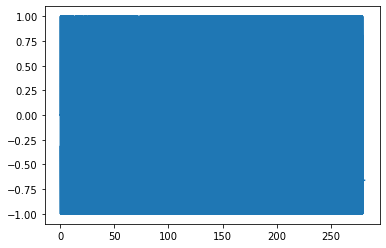

reconstructed [ONTIVA.COM]-Audrey Napoleon - Poison (OFFICIAL AUDIO)-HQ signal


In [9]:
output = generate_from_freqs(freqs,samplerate,chunk_size)

sf.write(filename + "_reconstructed.wav", output, samplerate)

x = np.linspace(0, len(output)/samplerate, len(output))
plt.plot(x, output)
plt.show()

print(f'reconstructed {filename} signal')
Audio(filename + "_reconstructed.wav", rate=samplerate)

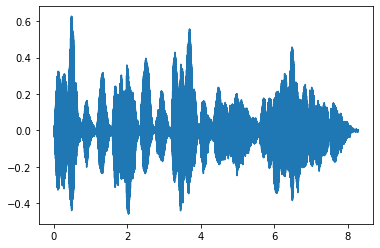

original seq/DWK_violin signal


In [7]:
x = np.linspace(0, sample_len, len(data))
plt.plot(x, data)
plt.show()

print(f'original {filename} signal')
Audio(filename + ".wav", rate=samplerate)

Harmonic magnitude spectrum may be modeled in a simplified way with a comb function, defined as a sum of equidistant window functions in the frequency domain (cf. Fig. 1). The shape of the window function may by arbitrary, e.g. gaussian or triangular (in a simplest case the window may be even reduced to a single impulse). The pitch of the sound corresponds directly to the distance between consecutive maxima of the comb function (the middle points of the consecutive windows).
In order to find the pitch of the analyzed sound, a set of comb functions must be applied, where each comb function has different distance between the consecutive maxima. Each comb function is represented in a discrete form, as a sequence of length equal to the number of elements of the analyzed spectrum and the inner product of the two is computed. In other words, we multiply – element by element – the comb function and the sound magnitude spectrum, summing the obtained products. The comb function for which the greatest sum is obtained is hence the best model of the input signal spectrum (we have “hit” the harmonics of the sound with the maxima of the comb function), so the distance between its maxima corresponds to the fundamental frequency we have been searching for.

In [8]:
import scipy.fft as fft
from scipy.signal import argrelextrema
from statistics import median


filename = 'artificial/diff/80Hz'
data, samplerate = sf.read(filename + ".wav", dtype='float64')
sample_len = len(data)/samplerate

In [9]:
@njit
def generate_comb(samples, separation):
    comb = np.zeros(shape=(samples))
    sep = 2*(separation + 1)
    for i in range(comb.shape[0]):
        if i % sep == 0:
            comb[i] = 1
        elif i % sep == int(sep/2):
            comb[i] = -10
        else:
            comb[i] = 0
    return comb
@njit
def autoccombcorrelation(data, comb):
    ac = np.zeros(shape=data.shape)
    for i in range(data.shape[0]):
        ac[i] = data[i] * comb[i]
    return np.sum(ac)

def hann_window(window_length):
    window = np.zeros(window_length)
    for i in range(1, window_length+1):
        window[i-1] = 0.5 * (1 - np.cos( (2*np.pi*i)/(window_length-1) ))
    return window

In [10]:
def combfilter_detection(data,samplerate,display_plots=False):
    yf = fft.rfft(data*hann_window(len(data)))#*hann_window(len(data)))#[:2048])#
    xf = fft.rfftfreq(len(data),1/samplerate)
    xf=xf[:len(xf)//4]
    yf=yf[:len(yf)//4]
    vals = []
    combs = []
    for i in range(2000):
        #if i%2 == 0: continue
        comb = generate_comb(len(xf),i)
        ac = autoccombcorrelation(np.abs(yf), comb)
        combs.append(comb)
        vals.append(ac)
        #print(i, _sum)
    index = np.argmax(vals)
    #print(index,vals[index])
    if display_plots:
        vis_incr = 20
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=xf, y=np.abs(yf)))   #plt.plot(xf,np.abs(yf))
        fig.add_trace(go.Scatter(x=xf, y=combs[index]*vis_incr,marker = {'color': 'red'}))
        fig.show()
    if len(xf)>index*2 : return combs,vals,xf[index*2]
    else: return combs,vals,index*2
     #index*2 = detected frequency



In [11]:
from pathlib import Path

pathlist = Path('artificial').rglob('*Hz.wav')
for path in pathlist:
    data, samplerate = sf.read(path, dtype='float64')
    print(f'file: {str(path)}; \t detected: {combfilter_detection(data,samplerate)[2]}Hz')
pathlist = Path('natural').rglob('*Hz.wav')
for path in pathlist:
    data, samplerate = sf.read(path, dtype='float64')
    print(f'file: {str(path)}; \t detected: {combfilter_detection(data,samplerate)[2]}Hz')

file: artificial\diff\120Hz.wav; 	 detected: 58.0Hz
file: artificial\diff\1366Hz.wav; 	 detected: 1364.0Hz
file: artificial\diff\180Hz.wav; 	 detected: 178.0Hz
file: artificial\diff\270Hz.wav; 	 detected: 268.0Hz
file: artificial\diff\405Hz.wav; 	 detected: 402.0Hz
file: artificial\diff\607Hz.wav; 	 detected: 606.0Hz
file: artificial\diff\80Hz.wav; 	 detected: 78.0Hz
file: artificial\diff\911Hz.wav; 	 detected: 910.0Hz
file: artificial\easy\100Hz.wav; 	 detected: 98.0Hz
file: artificial\easy\1139Hz.wav; 	 detected: 1138.0Hz
file: artificial\easy\150Hz.wav; 	 detected: 148.0Hz
file: artificial\easy\1708Hz.wav; 	 detected: 26.0Hz
file: artificial\easy\225Hz.wav; 	 detected: 224.0Hz
file: artificial\easy\337Hz.wav; 	 detected: 336.0Hz
file: artificial\easy\506Hz.wav; 	 detected: 504.0Hz
file: artificial\easy\759Hz.wav; 	 detected: 758.0Hz
file: artificial\med\1025Hz.wav; 	 detected: 1024.0Hz
file: artificial\med\135Hz.wav; 	 detected: 134.0Hz
file: artificial\med\1537Hz.wav; 	 detected: 9

In [14]:
filename = 'seq/DWK_violin'
data, samplerate = sf.read(filename + ".wav", dtype='float64')
sample_len = len(data)/samplerate
chunk_begin = 0
chunk_size = 2048
freqs = []

for chunk, chunk_begin, chunk_end in chunks(data,chunk_size):
    freq = combfilter_detection(data[chunk_begin:chunk_end],samplerate)[2]
    freqs.append(freq)
    print(f'Chunk {chunk_begin}:{chunk_end}. Frequency = {freq}')


Chunk 0:2048. Frequency = 473.73046875
Chunk 2048:4096. Frequency = 473.73046875
Chunk 4096:6144. Frequency = 473.73046875
Chunk 6144:8192. Frequency = 473.73046875
Chunk 8192:10240. Frequency = 3445.3125
Chunk 10240:12288. Frequency = 2454.78515625
Chunk 12288:14336. Frequency = 2411.71875
Chunk 14336:16384. Frequency = 2411.71875
Chunk 16384:18432. Frequency = 3574.51171875
Chunk 18432:20480. Frequency = 473.73046875
Chunk 20480:22528. Frequency = 473.73046875
Chunk 22528:24576. Frequency = 473.73046875
Chunk 24576:26624. Frequency = 473.73046875
Chunk 26624:28672. Frequency = 473.73046875
Chunk 28672:30720. Frequency = 473.73046875
Chunk 30720:32768. Frequency = 473.73046875
Chunk 32768:34816. Frequency = 473.73046875
Chunk 34816:36864. Frequency = 344.53125
Chunk 36864:38912. Frequency = 344.53125
Chunk 38912:40960. Frequency = 344.53125
Chunk 40960:43008. Frequency = 1335.05859375
Chunk 43008:45056. Frequency = 2713.18359375
Chunk 45056:47104. Frequency = 344.53125
Chunk 47104:491

In [15]:

output = generate_from_freqs(freqs,samplerate,chunk_size)

sf.write(filename + "_combfilter_reconstructed.wav", output, samplerate)
Audio(filename + "_combfilter_reconstructed.wav", rate=samplerate)